<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Description" data-toc-modified-id="Description-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Description</a></span></li><li><span><a href="#Status" data-toc-modified-id="Status-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Status</a></span><ul class="toc-item"><li><span><a href="#10-Nodes" data-toc-modified-id="10-Nodes-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>10 Nodes</a></span></li><li><span><a href="#25-Nodes" data-toc-modified-id="25-Nodes-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>25 Nodes</a></span></li><li><span><a href="#Takeway" data-toc-modified-id="Takeway-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Takeway</a></span></li></ul></li><li><span><a href="#Load" data-toc-modified-id="Load-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Load</a></span></li><li><span><a href="#10-Nodes" data-toc-modified-id="10-Nodes-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>10 Nodes</a></span><ul class="toc-item"><li><span><a href="#L-=-1000000" data-toc-modified-id="L-=-1000000-4.1"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>L = 1000000</a></span></li><li><span><a href="#L-=-1000" data-toc-modified-id="L-=-1000-4.2"><span class="toc-item-num">4.2&nbsp;&nbsp;</span>L = 1000</a></span></li></ul></li><li><span><a href="#25-Nodes" data-toc-modified-id="25-Nodes-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>25 Nodes</a></span><ul class="toc-item"><li><span><a href="#L-=-100000" data-toc-modified-id="L-=-100000-5.1"><span class="toc-item-num">5.1&nbsp;&nbsp;</span>L = 100000</a></span></li></ul></li><li><span><a href="#25-Nodes-WITH-LONGER-INNER-ITERATIONS" data-toc-modified-id="25-Nodes-WITH-LONGER-INNER-ITERATIONS-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>25 Nodes WITH LONGER INNER ITERATIONS</a></span><ul class="toc-item"><li><span><a href="#L-=-100000" data-toc-modified-id="L-=-100000-6.1"><span class="toc-item-num">6.1&nbsp;&nbsp;</span>L = 100000</a></span></li></ul></li><li><span><a href="#25-Nodes-with-fixed-step" data-toc-modified-id="25-Nodes-with-fixed-step-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>25 Nodes with fixed step</a></span></li></ul></div>

# Description

We have apparently solved the line search and the initialization problem. Can we generate results that speak to that? And that illustrate that indeed we have succeeded? 

# Status

Can I check whether the cost and the satisfaction of the ED problem on one given path is indeed impacted by the value of L ? 

If yes, then relative progress is no longer a good metric and should be adapted with a duality certificate. 

That might be related to the reason that it only takes 6 iterations here, while more than 50 for lower values. 

Below we see that at the end of some iterations, some paths are not really well satisfied for ED (costs differ by 1 %). We want much smaller. That might be due to the wrong requirement on the SC. 

## 10 Nodes

However, if we look for much smaller values of L, we see: 
- ED problem is much less well satisfied (while I was expecting it to be easier to solve as you don't have the big requirement from the rebalancing)
- the RP reached is only in the order of 10^-8. 

What might cause it are the parameters of the backtracking line search...



What is also important is to consider the following: 
- despite they are not reachgin 10^-10 for L =1000 for instance, the cost is still decreasing. I am sure we could reach the same values if you leave it run for much longer in the inner loop. 
- It might simply be due to the backtracking line search method. 

## 25 Nodes

The observation is similar for 25 Nodes. Assuming that 50 iterations is enough is a bit bold I believe. 

We should let it run until it reaches 10^-10 at any cost, or better have a certificate. 

## Takeway

- relative progress is a very subjective method and will indicate relatively good solutions depending on the size of the problem
- we need to let it run until it reaches a satisfactory solution otherwise it will give flawed results. 

# Load

In [1]:
%load_ext autoreload
%autoreload 2
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import pickle
import os
import pandas as pd

from amod_ed.result_analysis import plot_ri, print_final_flows, plot_cost_all_path, plot_ri_list, plot_balance_list
from amod_ed.result_analysis import plot_stop_and_cost

In [2]:
subfolder='Li_comparison'

# 10 Nodes

In [215]:
n_nodes=10

In [216]:
path='Data/'+str(n_nodes)+'Nodes/outputs/'+subfolder

In [217]:
print(os.listdir(path))

['output_L_1000000_ni_50_no_150_ev_0_relative_progress_fu_False.pkl', 'output_L_10000_ni_50_no_150_ev_0_relative_progress_fu_False.pkl', 'output_L_1000_ni_50_no_150_ev_0_relative_progress_fu_False.pkl', 'output_L_10000000_ni_50_no_150_ev_0_relative_progress_fu_False.pkl', 'output_L_10_ni_50_no_150_ev_0_relative_progress_fu_False.pkl', 'balance.png', 'output_L_100000_ni_50_no_150_ev_0_relative_progress_fu_False.pkl', 'output_L_100_ni_50_no_150_ev_0_relative_progress_fu_False.pkl']


## L = 1000000

In [6]:
with open(os.path.join(path, 'output_L_1000000_ni_50_no_150_ev_0_relative_progress_fu_False.pkl'), 'rb') as f:
        G_FW, OD, ri_FW, n_outer, n_inner, balance, opt_res, OD_list, balance_list, params = pickle.load(f)

In [7]:
params

{'L': 1000000,
 'ni': 50,
 'no': 150,
 'ev': False,
 'sc': 'relative_progress',
 'fu': False,
 'ri_smoothing': False,
 'update_factor': False,
 'FW_tol': 1e-10,
 'tol': 1e-10}

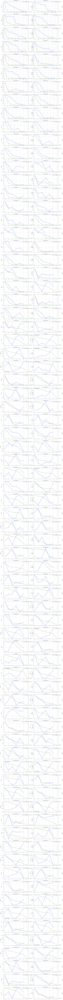

In [8]:
plot_stop_and_cost(opt_res)

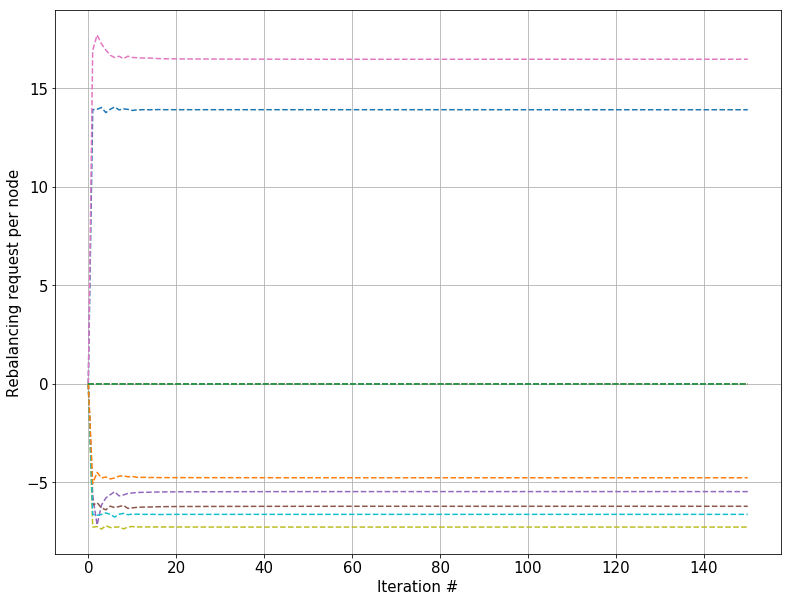

In [9]:
plot_ri_list(ri_FW, save = False, path = None)

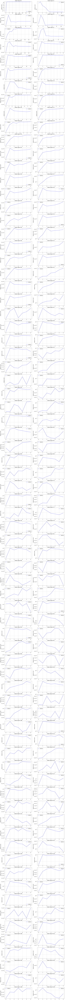

In [10]:
plot_balance_list(balance_list, b_scale='log')

No handles with labels found to put in legend.


Text(0, 0.5, 'Balance Norm')

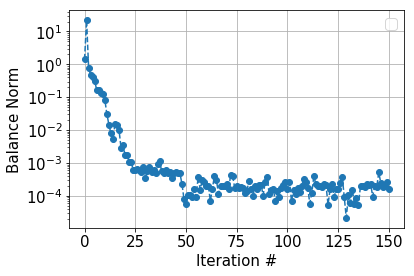

In [12]:
b=np.linalg.norm(balance, axis=1)
plt.plot(np.array(b), 'o--')
plt.grid(True)
plt.legend()
plt.yscale('log')
plt.xlabel('Iteration #')
plt.ylabel('Balance Norm')

In [21]:
path1 = ['0', '0_p']
path2 = ['0', '7', '0_p']
rel_diff_tot = []
for j in range(1, len(G_FW)):
    G = G_FW[j][-1]
    cp=[]
    for p in [path1, path2]:
        c = 0
        for i in range(len(p)-1):
            c+=G[p[i]][p[i+1]]['cost']
        cp.append(c)

    rel_diff = np.abs(cp[0]-cp[1])/cp[0]
    rel_diff_tot.append(rel_diff)

In [22]:
rel_diff_tot

[5.696258728358242e-06,
 0.01012047413901061,
 0.0016013845279981183,
 0.015712861419992844,
 4.4554739561978004e-05,
 0.030861719425725978,
 0.0010933260018419829,
 0.01057102290298548,
 0.003725037310928809,
 0.0020994231801419526,
 0.0011225094266803573,
 0.0008680386871877579,
 9.607300927554457e-05,
 3.858389564858528e-05,
 4.047708159285063e-06,
 0.0019824012833049966,
 0.0011915039010948203,
 0.0006158249918531677,
 0.0002890248138672616,
 1.4156578105887908e-05,
 4.0606892989443896e-07,
 9.498591455123921e-05,
 1.5671155266257435e-05,
 2.415871174856049e-05,
 3.283954001770194e-06,
 8.664289053679703e-06,
 3.5325006996835956e-05,
 4.14394856073825e-06,
 1.7683396633647313e-05,
 1.0728473571146634e-05,
 2.2097741556533232e-05,
 3.835589458425283e-07,
 1.2134558951756819e-05,
 1.5191813958005739e-05,
 7.80820495379292e-06,
 1.393550214337954e-05,
 5.739183378912389e-05,
 1.2198483379214188e-05,
 2.6989574263436102e-05,
 4.5330172821691993e-07,
 5.878088712420588e-06,
 1.725184851

In [23]:
path1 = ['5','5_p']
path2 = ['5','4','1','0','3','9','5_p']

rel_diff_tot = []
for j in range(1, len(G_FW)):
    G = G_FW[j][-1]
    cp=[]
    for p in [path1, path2]:
        c = 0
        for i in range(len(p)-1):
            c+=G[p[i]][p[i+1]]['cost']
        cp.append(c)

    rel_diff = np.abs(cp[0]-cp[1])/cp[0]
    rel_diff_tot.append(rel_diff)

In [25]:
rel_diff_tot

[1.9437619827262917e-05,
 0.04522122395647689,
 0.023087412097728622,
 0.006723564380903304,
 0.012282356837710024,
 3.438177196955335e-06,
 0.0009940244878473797,
 0.007043626115718703,
 0.0009548260937977604,
 0.0036601324962099173,
 0.000393599241820502,
 0.00038877544963318475,
 5.2899512824965655e-05,
 0.001157918047378921,
 4.774563768183259e-05,
 0.00042210746924678343,
 9.260761870776412e-06,
 0.00015850978945542254,
 9.122789562073632e-06,
 5.7093518753301854e-05,
 4.48055501740714e-06,
 1.3754676579678376e-05,
 1.8820272543962346e-05,
 1.6245831211550532e-05,
 7.04266582188135e-06,
 3.019722860079984e-05,
 2.1245552420116745e-05,
 1.1139782047133023e-05,
 6.542241563340952e-06,
 4.4244224152705375e-05,
 1.539210768505325e-05,
 3.6901655133263687e-07,
 1.9080236543966567e-05,
 9.06185162925807e-06,
 4.161870806760145e-05,
 5.079725102546935e-06,
 3.4139630149049816e-06,
 2.2276129303288872e-05,
 1.0899283584277533e-05,
 1.737587658009796e-06,
 3.433284890082008e-05,
 8.9969038

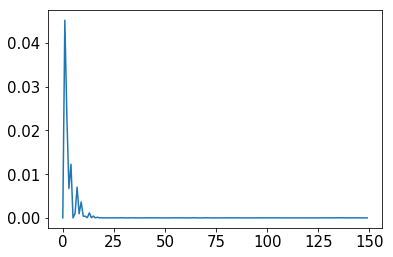

In [26]:
plt.plot(rel_diff_tot)

## L = 1000

In [221]:
with open(os.path.join(path, 'output_L_1000_ni_50_no_150_ev_0_relative_progress_fu_False.pkl'), 'rb') as f:
        G_FW, OD, ri_FW, n_outer, n_inner, balance, opt_res, OD_list, balance_list, params = pickle.load(f)

In [222]:
params

{'L': 1000,
 'ni': 50,
 'no': 150,
 'ev': False,
 'sc': 'relative_progress',
 'fu': False,
 'ri_smoothing': False,
 'update_factor': False,
 'FW_tol': 1e-10,
 'tol': 1e-10}

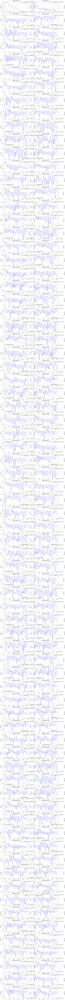

In [223]:
plot_stop_and_cost(opt_res)

In [224]:
opt_res[-1]['obj']

[1160030.6927743927,
 1160030.6924431028,
 1160030.6913530813,
 1160030.6912250754,
 1160030.689310527,
 1160030.6877663373,
 1160030.6876218142,
 1160030.6869842992,
 1160030.6860902691,
 1160030.6789317233,
 1160030.6780377435,
 1160030.6771496397,
 1160030.676118638,
 1160030.6699011186,
 1160030.6684860527,
 1160030.6658953803,
 1160030.6651011584,
 1160030.6642268556,
 1160030.662720091,
 1160030.6606258908,
 1160030.659819248,
 1160030.6593308484,
 1160030.6578813621,
 1160030.6558880415,
 1160030.6550032808,
 1160030.6548291997,
 1160030.6528890114,
 1160030.6509579746,
 1160030.6499698265,
 1160030.649311731,
 1160030.6488553677,
 1160030.6481972965,
 1160030.6472700315,
 1160030.6471274982,
 1160030.6453577392,
 1160030.6396445865,
 1160030.637955418,
 1160030.6356343732,
 1160030.6345895287,
 1160030.6341094887,
 1160030.6325018045,
 1160030.6304067688,
 1160030.6294092976,
 1160030.628731758,
 1160030.6283337031,
 1160030.6273739892,
 1160030.6266609968,
 1160030.6243214747,

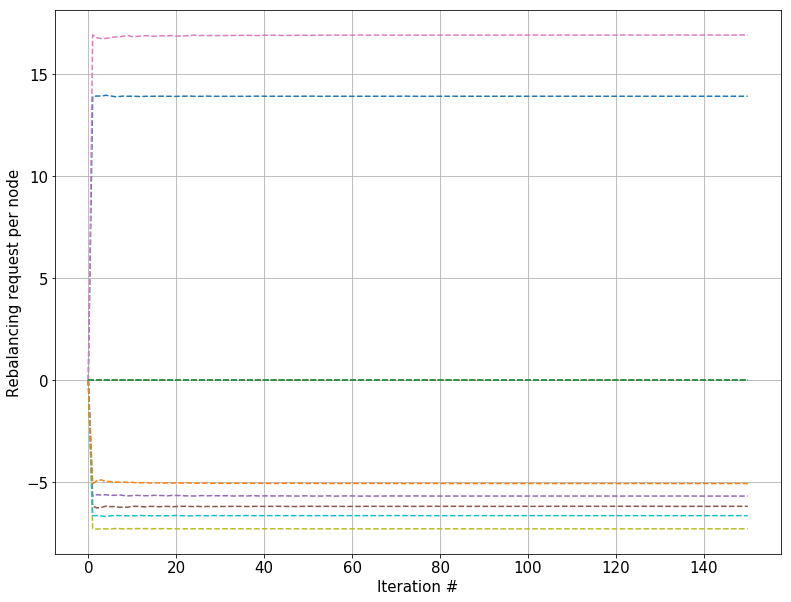

In [225]:
plot_ri_list(ri_FW, save = False, path = None)

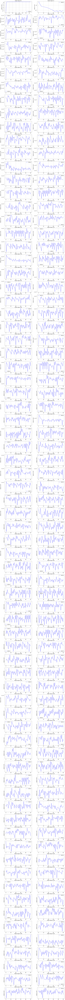

In [32]:
plot_balance_list(balance_list, b_scale='log')

No handles with labels found to put in legend.


Text(0, 0.5, 'Balance Norm')

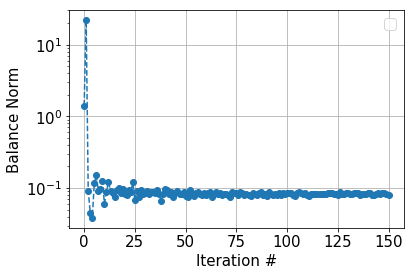

In [33]:
b=np.linalg.norm(balance, axis=1)
plt.plot(np.array(b), 'o--')
plt.grid(True)
plt.legend()
plt.yscale('log')
plt.xlabel('Iteration #')
plt.ylabel('Balance Norm')

In [34]:
path1 = ['0', '0_p']
path2 = ['0', '7', '0_p']
rel_diff_tot = []
for j in range(1, len(G_FW)):
    G = G_FW[j][-1]
    cp=[]
    for p in [path1, path2]:
        c = 0
        for i in range(len(p)-1):
            c+=G[p[i]][p[i+1]]['cost']
        cp.append(c)

    rel_diff = np.abs(cp[0]-cp[1])/cp[0]
    rel_diff_tot.append(rel_diff)

In [35]:
rel_diff_tot

[5.696258728358242e-06,
 0.0005436670665054993,
 0.0031815271033616916,
 0.009996896384302924,
 0.002067731415223999,
 0.001439361546436495,
 0.0006860324472247365,
 0.001281854303887039,
 0.001878742041141573,
 0.00028517611427942587,
 0.001600366797716525,
 0.001536770201078083,
 0.0017877401873513342,
 0.0006514326249016056,
 0.002427364379785466,
 0.0005884997249534061,
 0.002387970177819232,
 0.0005550573127587144,
 0.00021510196588447636,
 0.00134530531868029,
 0.0010898757316073105,
 0.0009827475898747003,
 0.002713445338090366,
 0.0004319446735290958,
 0.00031813453953881486,
 6.628152292076084e-05,
 0.0023061362794380676,
 0.000654080989201929,
 6.250748640389205e-05,
 0.0004496857198095475,
 0.00043242084295874126,
 0.000489498297188372,
 0.0013612971840936303,
 0.0004500222946227993,
 0.0002510835922555638,
 0.0006622612134864651,
 0.000569172595669031,
 0.0010713276202789057,
 0.0005407863604051071,
 0.00037152875654001644,
 0.0005520328619857785,
 0.001033145098918936,
 0.

In [36]:
path1 = ['5','5_p']
path2 = ['5','4','1','0','3','9','5_p']

rel_diff_tot = []
for j in range(1, len(G_FW)):
    G = G_FW[j][-1]
    cp=[]
    for p in [path1, path2]:
        c = 0
        for i in range(len(p)-1):
            c+=G[p[i]][p[i+1]]['cost']
        cp.append(c)

    rel_diff = np.abs(cp[0]-cp[1])/cp[0]
    rel_diff_tot.append(rel_diff)

In [37]:
rel_diff_tot

[1.9437619827262917e-05,
 0.0028697182262966,
 0.0038642181411479063,
 0.002042568833504855,
 0.0002425313138741214,
 0.0020889212930955267,
 6.924809383152095e-05,
 0.0018842541836042944,
 0.0034935802693308866,
 0.0006898353402773809,
 0.0025015178681672074,
 0.002091534298533791,
 0.00037808818356990646,
 0.0025197813114119566,
 0.0005611197699070033,
 9.086971364180357e-05,
 0.002214403155660978,
 0.00010106088375874469,
 0.0016766821715789085,
 0.0008571782477247642,
 0.0010516491740185693,
 0.00037898009711397485,
 0.0002766092006377943,
 0.0029977979966092547,
 3.582523866005629e-05,
 0.0013965742178245941,
 0.0007297123987075623,
 0.0011765330116209538,
 0.00040239816460770647,
 0.0010115736002545674,
 0.0005581840548111713,
 0.0003046372404979215,
 0.0003845050005201514,
 0.000851650241648348,
 0.0005446245153327462,
 0.0007109650197860238,
 0.000850035719790924,
 0.000324203664526381,
 0.00035588078557798844,
 0.0013590543532346034,
 0.0014141737486098745,
 0.0014078066203032

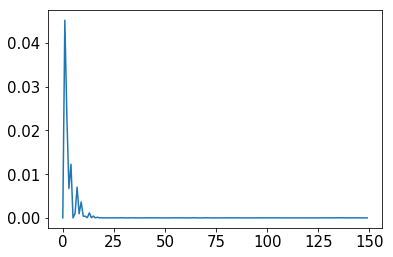

In [26]:
plt.plot(rel_diff_tot)

# 25 Nodes

We see we always have to recompute, it does not really stabilize because the ri oscillate. We always have to make huge strides and huge progress in a given iteration. While we were expecting, upon stabilization of the r_i, that this would not be needed...

In [226]:
n_nodes=25

In [227]:
path='Data/'+str(n_nodes)+'Nodes/outputs/'+subfolder

In [228]:
print(os.listdir(path))

['output_L_10000_ni_150_no_150_ev_0_relative_progress_fu_False.pkl', 'output_L_10_ni_150_no_150_ev_0_relative_progress_fu_False.pkl', 'output_L_10000000_ni_150_no_150_ev_0_relative_progress_fu_False.pkl', 'balance.png', 'output_L_1000_ni_150_no_150_ev_0_relative_progress_fu_False.pkl', 'output_L_100000_ni_150_no_150_ev_0_relative_progress_fu_False.pkl', 'output_L_1000000_ni_150_no_150_ev_0_relative_progress_fu_False.pkl', 'output_L_100_ni_150_no_150_ev_0_relative_progress_fu_False.pkl']


## L = 100000

In [229]:
with open(os.path.join(path, 'output_L_100000_ni_150_no_150_ev_0_relative_progress_fu_False.pkl'), 'rb') as f:
        G_FW, OD, ri_FW, n_outer, n_inner, balance, opt_res, OD_list, balance_list, params = pickle.load(f)

In [230]:
params

{'L': 100000,
 'ni': 150,
 'no': 150,
 'ev': False,
 'sc': 'relative_progress',
 'fu': False,
 'ri_smoothing': False,
 'update_factor': False,
 'FW_tol': 1e-10,
 'tol': 1e-10}

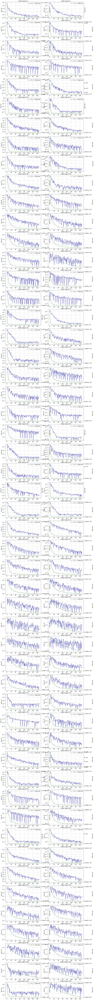

In [74]:
plot_stop_and_cost(opt_res)

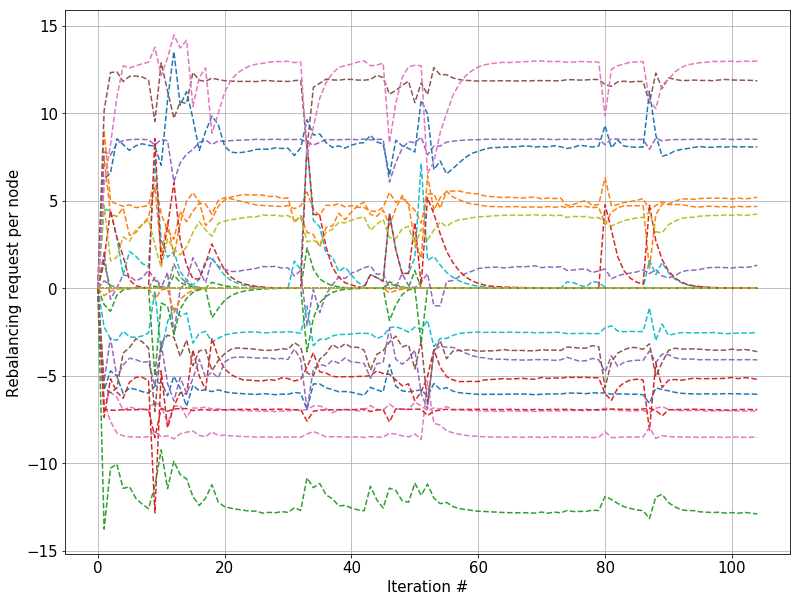

In [75]:
plot_ri_list(ri_FW, save = False, path = None)

No handles with labels found to put in legend.


Text(0, 0.5, 'Balance Norm')

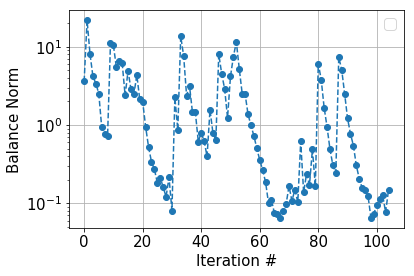

In [76]:
b=np.linalg.norm(balance, axis=1)
plt.plot(np.array(b), 'o--')
plt.grid(True)
plt.legend()
plt.yscale('log')
plt.xlabel('Iteration #')
plt.ylabel('Balance Norm')

I guess that the oscillations stem from the fact that we do not really solve the ED problem. Why do I think that? The relative progress is still large compared to the scale of the total cost...

And it is not because you are stuck at a given order of relative progress that the cost does not decrease!!!!! It can decrease slower of course!!

We see it has not stabilized AT ALL Lucas!! The changes are still on very large order (changes of costs). 

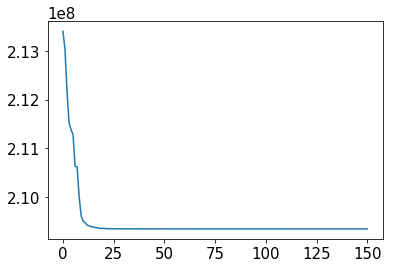

In [233]:
plt.plot(opt_res[18]['obj'])

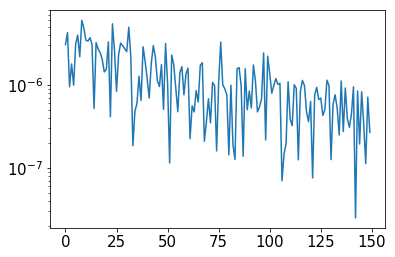

In [193]:
plt.plot(opt_res[-1]['stop'])
plt.yscale('log')

In [234]:
G_ = G_FW[17][-1].copy()
ri_ = ri_FW[17].copy()

Let us try to run the very same iteration, but understand what it takes to have it run really well. 

In [170]:
from amod_ed.FW_OuterUpdate import FW_graph_extension

In [235]:
G_list, _, opt_res_k, OD_list_k, n_iter, balance_ = FW_graph_extension(
                G_, OD.copy(), list(G_.edges()), ri_, FW_tol=0,
                step='line_search', evolving_bounds=False, max_iter=150,
                stopping_criterion='relative_progress', update_factor=False, i_offset=0)

Initialization problem status:  optimal
    Max inner iterations reached
     Number of inner loop iterations:  150


With 150 iterations

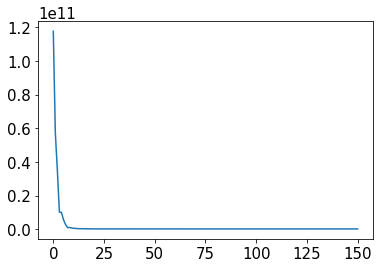

In [236]:
plt.plot(opt_res_k['obj'])

With 150 iterations

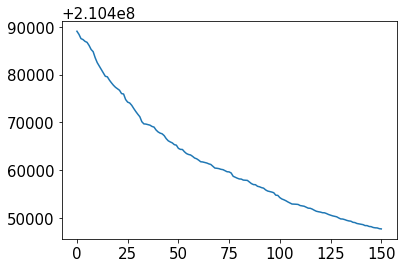

In [182]:
plt.plot(opt_res_k['obj'])

Wihth 500 iterations

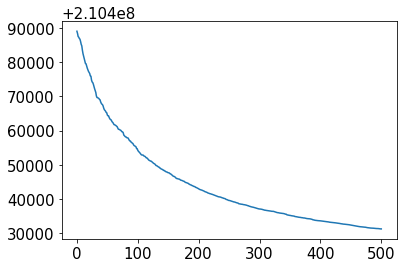

In [184]:
plt.plot(opt_res_k['obj'])

With 1000 iterations

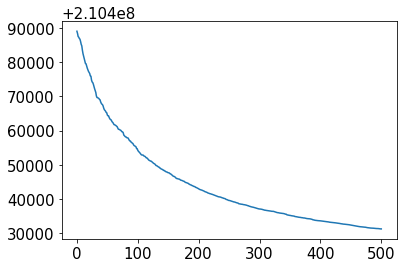

In [184]:
plt.plot(opt_res_k['obj'])

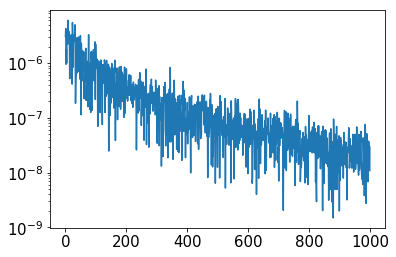

In [191]:
plt.plot(opt_res_k['stop'])
plt.yscale('log')

In [188]:
cp=[]
G = G_list[-1]
for p in nx.all_simple_paths(G, '9', '9_p'):
    c = 0
    for i in range(len(p)-1):
        c+=G[p[i]][p[i+1]]['cost']
    cp.append(c)

In [189]:
cp

[1067.0830471641016, 959.8977705185181, 959.9044161310328, 960.0]

We now see that by giving it more time in some cases, we indeed reach a much better solution to the ED problem. 

The question now is how to know how many inner iterations? 
We need an objective criterion rather than a heuristic like relative progress (whose relevance really disappears when the scale of the problem increases. 

With 5000 iterations

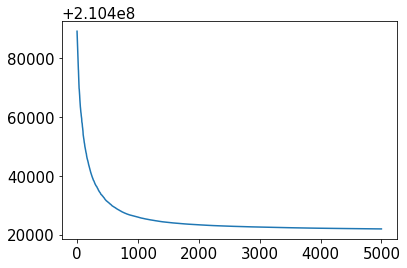

In [195]:
plt.plot(opt_res_k['obj'])

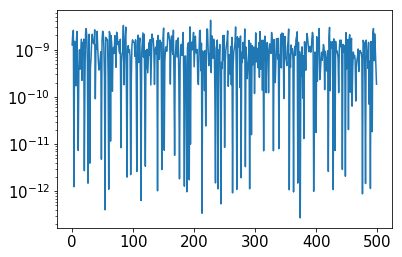

In [199]:
plt.plot(opt_res_k['stop'][4500:])
plt.yscale('log')

In [197]:
cp=[]
G = G_list[-1]
for p in nx.all_simple_paths(G, '9', '9_p'):
    c = 0
    for i in range(len(p)-1):
        c+=G[p[i]][p[i+1]]['cost']
    cp.append(c)

In [198]:
cp

[1046.6191942288867, 960.0247249428458, 960.0183108209567, 960.0]

Before re-running experiments, make sure you understand why there are oscillations. I believe it is because we sometimes don't really solve the ED problem? 

In [101]:
cp=[]
G = G_FW[18][-1]
for p in nx.all_simple_paths(G, '9', '9_p'):
    c = 0
    for i in range(len(p)-1):
        c+=G[p[i]][p[i+1]]['cost']
    cp.append(c)

In [102]:
cp

[1095.0011863420718, 973.8384092211552, 960.0418451124344, 960.0]

In [103]:
cp=[]
G = G_FW[-1][-1]
for p in nx.all_simple_paths(G, '9', '9_p'):
    c = 0
    for i in range(len(p)-1):
        c+=G[p[i]][p[i+1]]['cost']
    cp.append(c)

In [104]:
cp

[1077.1870551139325, 961.3112955646467, 960.875449139286, 960.0]

In [113]:
G['9']['9_p']['f_m']

16.99915238569713

We see that for a given iteration, the cost of the second path is not close to 960 at all. Difficult to optimize... 

However, the reason why that is, I don't know. I think it is due to the stepping routine: we are not taking the exact minimum to this problem... 

In [107]:
cp=[]
G = G_FW[18][-1]
for p in nx.all_simple_paths(G, '2', '2_p'):
    c = 0
    for i in range(len(p)-1):
        c+=G[p[i]][p[i+1]]['cost']
    cp.append(c)

In [108]:
cp

[1025.4802751768655, 992.7323173312668, 960.0]

In [109]:
cp=[]
G = G_FW[-1][-1]
for p in nx.all_simple_paths(G, '2', '2_p'):
    c = 0
    for i in range(len(p)-1):
        c+=G[p[i]][p[i+1]]['cost']
    cp.append(c)

In [110]:
cp

[1020.6095877711498, 1001.2251507148479, 960.0]

In [112]:
G['2']['2_p']['f_m']

19.993291895628

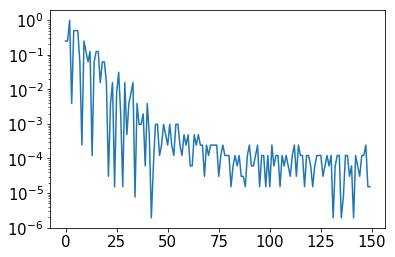

In [124]:
plt.figure()
plt.plot(opt_res[17]['a_k'])
plt.yscale('log')

# 25 Nodes WITH LONGER INNER ITERATIONS

WE HAVE SEEN THAT THE VALUE OF RELATIVE PROGRESS WAS NOT REALLY ATTAINED AND THAT IT IS ALSO NOT SOLVING THE PROBLEM EXACTLY AT EACH ITERATION. THEREFORE WE LET IT RUN LONGER AND LET IT ATTAIN THE FW TOL SO THAT IT INDEED REACHES WHAT WE WANT

We see we always have to recompute, it does not really stabilize because the ri oscillate. We always have to make huge strides and huge progress in a given iteration. While we were expecting, upon stabilization of the r_i, that this would not be needed...

In [237]:
subfolder = 'Li_comparison_ni_5000'

In [238]:
n_nodes=25

In [239]:
path='Data/'+str(n_nodes)+'Nodes/outputs/'+subfolder

In [240]:
print(os.listdir(path))

['output_L_100000_ni_5000_no_50_ev_0_relative_progress_fu_False.pkl', 'output_L_1000_ni_5000_no_50_ev_0_relative_progress_fu_False.pkl', 'balance.png']


## L = 100000

In [241]:
with open(os.path.join(path, 'output_L_100000_ni_5000_no_50_ev_0_relative_progress_fu_False.pkl'), 'rb') as f:
        G_FW, OD, ri_FW, n_outer, n_inner, balance, opt_res, OD_list, balance_list, params = pickle.load(f)

In [242]:
params

{'L': 100000,
 'ni': 5000,
 'no': 50,
 'ev': False,
 'sc': 'relative_progress',
 'fu': False,
 'ri_smoothing': False,
 'update_factor': False,
 'FW_tol': 1e-08,
 'tol': 1e-10}

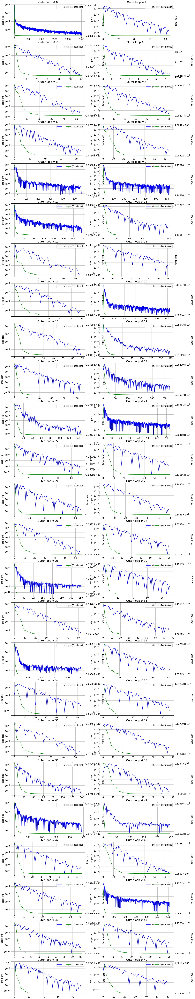

In [243]:
plot_stop_and_cost(opt_res)

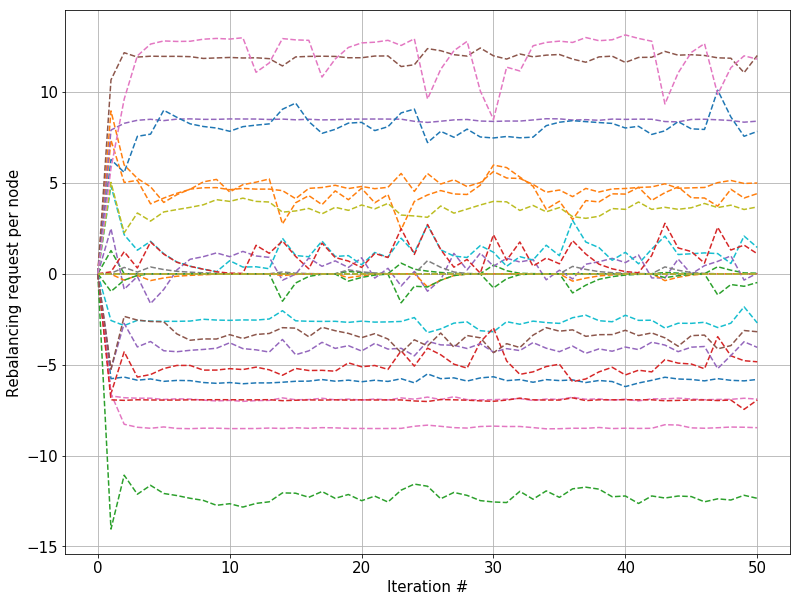

In [244]:
plot_ri_list(ri_FW, save = False, path = None)

No handles with labels found to put in legend.


Text(0, 0.5, 'Balance Norm')

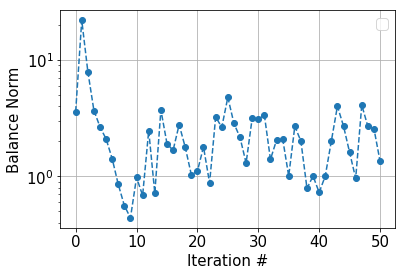

In [245]:
b=np.linalg.norm(balance, axis=1)
plt.plot(np.array(b), 'o--')
plt.grid(True)
plt.legend()
plt.yscale('log')
plt.xlabel('Iteration #')
plt.ylabel('Balance Norm')

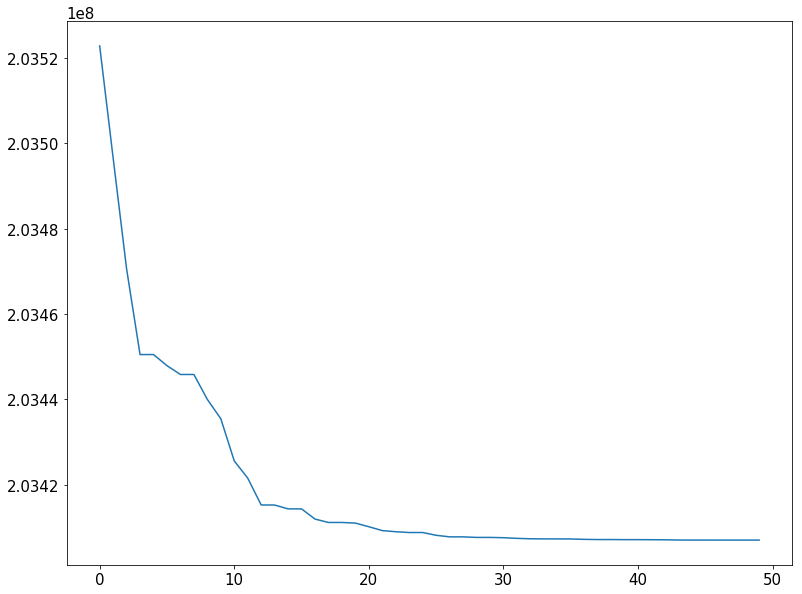

In [251]:
plt.figure(figsize = (13,10))
plt.plot(opt_res[29]['obj'][-50:])


In [252]:
opt_res[29]['obj']

[14950270300.442577,
 14949022478.064941,
 10641910246.10848,
 8068394943.470012,
 8067446346.356068,
 4680908012.5309925,
 1870305450.9148,
 1025610501.8826634,
 473656026.805109,
 307456883.25356126,
 278165433.0082484,
 278163890.4446148,
 273406270.7793848,
 273400635.56884384,
 252412589.5801382,
 251790138.51101613,
 227939724.5191426,
 220579596.2113854,
 215526814.91161555,
 213742079.30435985,
 210776391.07605594,
 207050867.86685804,
 207050758.9408092,
 206606277.9273756,
 206606244.86897853,
 206450616.07937714,
 206304852.13808653,
 205308498.03167927,
 204971833.78160498,
 204634930.23915312,
 204632043.7464014,
 204216938.49939215,
 203966283.75062984,
 203791745.4613136,
 203791741.85006487,
 203768237.68158248,
 203768229.54116425,
 203739028.780384,
 203722385.43908152,
 203607606.87401202,
 203572222.68389615,
 203522964.92645034,
 203522714.6247381,
 203496522.102428,
 203470556.76210877,
 203450511.5202316,
 203450511.05929497,
 203447915.83026695,
 203445851.52150

Big question: why does line search fail while fixed step kind of works for 25 nodes?? 
- I can't understand this
- Maybe it is because the ED problem is not solved as well


Need to look into the fixed step solutions. check: 
- what are the costs reached
- are they actually ED well solved
- How do they compare to 25 Nodes. 

# 25 Nodes with fixed step

Here we want to check why with 25 Nodes the problem kind of seems to work with the fixed step but not the line search. 

In [253]:
subfolder = 'Li_comparison_fixed_step'

In [254]:
n_nodes=25

In [255]:
path='Data/'+str(n_nodes)+'Nodes/outputs/'+subfolder

In [256]:
print(os.listdir(path))

['output_L_10000_ni_1000_no_50_ev_0_relative_progress_fu_False.pkl', 'output_L_10_ni_1000_no_50_ev_0_relative_progress_fu_False.pkl', 'output_L_10000000_ni_1000_no_50_ev_0_relative_progress_fu_False.pkl', 'balance.png', 'output_L_100000_ni_1000_no_50_ev_0_relative_progress_fu_False.pkl', 'output_L_1000_ni_1000_no_50_ev_0_relative_progress_fu_False.pkl', 'output_L_100_ni_1000_no_50_ev_0_relative_progress_fu_False.pkl', 'output_L_1000000_ni_1000_no_50_ev_0_relative_progress_fu_False.pkl']


In [257]:
with open(os.path.join(path, 'output_L_1000000_ni_1000_no_50_ev_0_relative_progress_fu_False.pkl'), 'rb') as f:
        G_FW, OD, ri_FW, n_outer, n_inner, balance, opt_res, OD_list, balance_list, params = pickle.load(f)

In [258]:
params

{'L': 1000000,
 'ni': 1000,
 'no': 50,
 'ev': False,
 'sc': 'relative_progress',
 'fu': False,
 'ri_smoothing': False,
 'update_factor': False,
 'FW_tol': 1e-10,
 'tol': 1e-10}

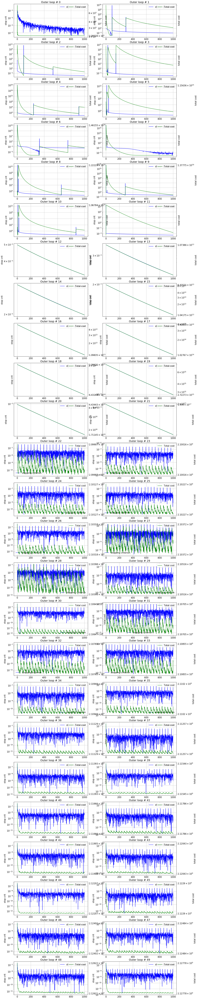

In [259]:
plot_stop_and_cost(opt_res)

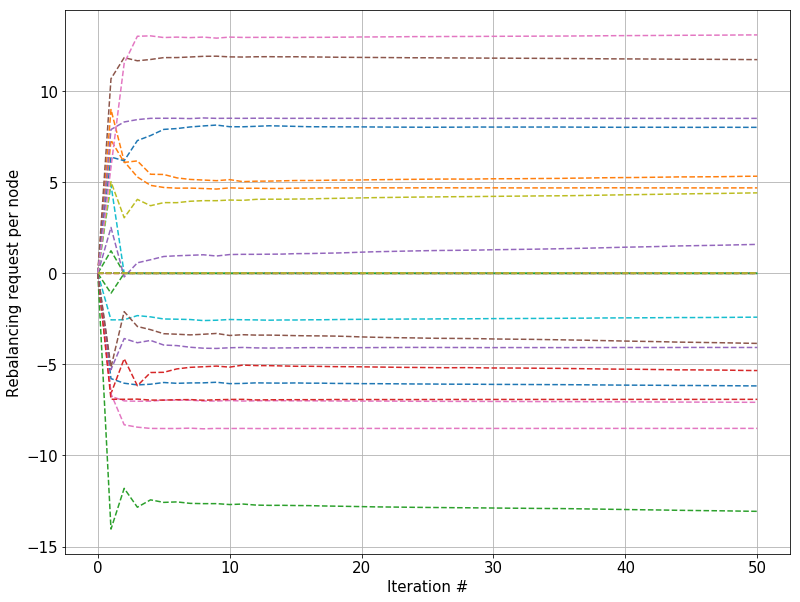

In [260]:
plot_ri_list(ri_FW, save = False, path = None)

No handles with labels found to put in legend.


Text(0, 0.5, 'Balance Norm')

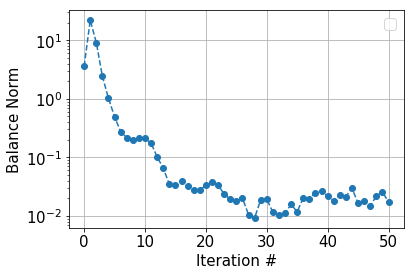

In [261]:
b=np.linalg.norm(balance, axis=1)
plt.plot(np.array(b), 'o--')
plt.grid(True)
plt.legend()
plt.yscale('log')
plt.xlabel('Iteration #')
plt.ylabel('Balance Norm')

In [262]:
cp=[]
G = G_FW[-1][-1]
for p in nx.all_simple_paths(G, '9', '9_p'):
    c = 0
    for i in range(len(p)-1):
        c+=G[p[i]][p[i+1]]['cost']
    cp.append(c)

In [263]:
cp

[1066.7077831402737, 959.9132027041504, 959.9402872872131, 960.0]

We still have a pretty damn good ED... 